#1. Author

**Student Name:** Benita Ashley

**Student Id:** 220058151


#2. Problem Formulation

We are trying to build a Machine learning pipleline which takes the input of two songs i.e Potter and Starwars audio file in our case and and predict the song using the MLEnd Hums and whistles dataset.
Since these two songs are very familiar in their tune, it becomes a challenge to differentiate between the two when words are not part of the recording which can be used as a better predictor. 

#3. Machine Learning Pipeline

The pipeline consists of the following activities in the given order:

1. Data Loading and Mounting 
2. Data Cleaning
3. Feature Extraction
4. Data Preprosessing
5. Data Visualisation
6. Different Model Training

The project will progress in the order of the steps as mentioned above and each step will be ellaborated with relevant code and analysis.

#Environment set up

In this section we will set up a Colab environment for the MLEnd mini-project. Before starting, follow these simple instructions:

1.   Go to https://drive.google.com/
2.   Create a folder named 'Data'in 'MyDrive': On the left, click 'New' > 'Folder', enter the name 'Data', and click 'create'
3.  Open the 'Data' Folder and creatw a folder named 'ECS7020P'

We will start by loading a few useful Python libraries and mounting our personal Google Drive storage system.



In [ ]:
from google.colab import drive

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

# Import seaborn
import seaborn as sns
from sklearn.model_selection import GridSearchCV
import sklearn

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV

#from IPython.display import Audio
import IPython.display as ipd
from tqdm import tqdm
import librosa

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


# Data download

Defines a function that will allow us to download a file into a chosen location.

In [ ]:
def download_url(url, save_path):
    with urllib.request.urlopen(url) as dl_file:
        with open(save_path, 'wb') as out_file:
            out_file.write(dl_file.read())

To download the zip into the designated folder.

In [ ]:
#Potter1
url1  = "https://collect.qmul.ac.uk/down?t=6P0I5CAE7JPPKNDU/4P729FD6DFNO8IT4NNFR458"
save_path1 = '/content/drive/MyDrive/Data/ECS7020P/Potter1.zip'
download_url(url1, save_path1)

In [ ]:
#Potter2
url2 = "https://collect.qmul.ac.uk/down?t=452THMOKUOST11V4/4L7IBFL5AJ3AMR45JVV9AC0"
save_path2 = '/content/drive/MyDrive/Data/ECS7020P/Potter2.zip'
download_url(url2, save_path2)

In [ ]:
#Potter3
url3 = "https://collect.qmul.ac.uk/down?t=4HOGB7IH67J8QGL3/5D5TJMIP30DFVC69AQU5ETO"
save_path3 = '/content/drive/MyDrive/Data/ECS7020P/StarWars1.zip'
download_url(url3, save_path3)

In [ ]:
#Potter4
url4 = "https://collect.qmul.ac.uk/down?t=4LUHB7IH67J8QGL3/6T5IF3SK8KQTL7FRD2113DO"
save_path4 = '/content/drive/MyDrive/Data/ECS7020P/StarWars2.zip'
download_url(url4, save_path4)

Run the following cell to check that the ECS7020 folder contains the 4 zipped files that we downloaded from the public folder i.e. Potter1.zip, Potter2.zip, StarWars1.zip, StarWars2.zip

In [ ]:
path = '/content/drive/MyDrive/Data/ECS7020P'
os.listdir(path)

['Advanced', 'Basic']

#Understanding our Dataset Sample

**Step:** Unzip the files and then determine the total number of audio files in the folder 'Basic'

In [ ]:
#Potter1
directory_to_extract_to = '/content/drive/MyDrive/Data/ECS7020P/Basic/'
zip_path = '/content/drive/MyDrive/Data/ECS7020P/Potter1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)


In [ ]:
#Potter2
directory_to_extract_to = '/content/drive/MyDrive/Data/ECS7020P/Basic/'
zip_path = '/content/drive/MyDrive/Data/ECS7020P/Potter2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)


In [ ]:
#StarWars1
directory_to_extract_to = '/content/drive/MyDrive/Data/ECS7020P/Basic/'
zip_path = '/content/drive/MyDrive/Data/ECS7020P/StarWars1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)


In [ ]:
#StarWars2
directory_to_extract_to = '/content/drive/MyDrive/Data/ECS7020P/Basic/'
zip_path = '/content/drive/MyDrive/Data/ECS7020P/StarWars2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)


In [ ]:
#number of audio files in the 'Basic' Folder
sample_path = '/content/drive/MyDrive/Data/ECS7020P/Basic/*.wav'
files = glob.glob(sample_path)
len(files)

823

Listen to 5 random audio files to see if we can differentiate between hums and whistles.

In [ ]:
#Random songs from the BasicSolution File
for _ in range(5):
  n = np.random.randint(206)
  display(ipd.Audio(files[n]))

In [ ]:
#Print names of the audio files
for file in files:
  print(file.split('/')[-1])

S1_hum_2_Potter.wav
S1_whistle_2_Potter.wav
S2_hum_2_Potter.wav
S2_whistle_2_Potter.wav
S3_hum_1_Potter.wav
S3_hum_2_Potter.wav
S4_hum_1_Potter.wav
S4_hum_2_Potter.wav
S5_hum_1_Potter.wav
S5_hum_2_Potter.wav
S6_hum_2_Potter.wav
S6_whistle_2_Potter.wav
S7_hum_1_Potter.wav
S7_hum_2_Potter.wav
S8_hum_1_[Potter].wav
S8_hum_4_[Potter].wav
S9_hum_1_Potter.wav
S9_hum_2_Potter.wav
S10_hum_1_Potter .wav
S10_hum_2_Potter .wav
S12_hum_2_Potter .wav
S12_hum_4_Potter .wav
S13_hum_1_Potter.wav
S13_hum_2_Potter.wav
S15_hum_2_Potter.wav
S15_whistle_2_Potter.wav
S16_hum_2_Potter.wav
S16_whistle_2_Potter.wav
S17_hum_1_Potter.wav
S17_hum_2_Potter.wav
S18_Hum_2_Potter.wav
S18_Whistle_2_Potter.wav
S19_hum_1_Potter.wav
S19_hum_2_Potter.wav
S20_hum_1_Potter.wav
S20_hum_2_Potter.wav
S21_hum_1_Potter.wav
S21_hum_2_Potter.wav
S22_hum_1_Potter.wav
S22_hum_2_Potter.wav
S23_hum_1_Potter.wav
S23_hum_2_Potter.wav
S24_hum_2_Potter.wav
S24_whistle_2_Potter.wav
S25_hum_1_Potter.wav
S25_hum_2_Potter.wav
S26_hum_1_Potter

As you can see, the name of each file follows the naming convention `[Participant ID]_[type of recording]_[interpretation number]_[song]`. We can parse each file name and extract this information. Let's do it for the first one:

In [ ]:
print('The full path to the first audio file is: ', files[0])
print('\n')
print('The name of the first audio file is: ', files[0].split('/')[-1])
print('    The participand ID is: ', files[0].split('/')[-1].split('_')[0])
print('    The type of interpretation is: ', files[0].split('/')[-1].split('_')[1])
print('    The interpretation number is: ', files[0].split('/')[-1].split('_')[2])
print('    The song is: ', files[0].split('/')[-1].split('_')[3])

The full path to the first audio file is:  /content/drive/MyDrive/Data/ECS7020P/Basic/S1_hum_2_Potter.wav


The name of the first audio file is:  S1_hum_2_Potter.wav
    The participand ID is:  S1
    The type of interpretation is:  hum
    The interpretation number is:  2
    The song is:  Potter.wav


#Data Cleaning




Before we go any further, we should first used regular expression to filter out any file names that don't have the right structure.

In [ ]:
pattern = re.compile(r'(S\d+_hum_[1-4]_Potter\.wav[^.\s]|S\d+_whistle_[12]_Potter\.wav[^.\s]|S\d+_hum_[1-4]_StarWars\.wav[^.\s]|S\d+_whistle_[12]_StarWars\.wav[^.\s])')

In [ ]:
f=str(files)
cleanfiles = pattern.findall(f)

In [ ]:
print(cleanfiles)

["S1_hum_2_Potter.wav'", "S1_whistle_2_Potter.wav'", "S2_hum_2_Potter.wav'", "S2_whistle_2_Potter.wav'", "S3_hum_1_Potter.wav'", "S3_hum_2_Potter.wav'", "S4_hum_1_Potter.wav'", "S4_hum_2_Potter.wav'", "S5_hum_1_Potter.wav'", "S5_hum_2_Potter.wav'", "S6_hum_2_Potter.wav'", "S6_whistle_2_Potter.wav'", "S7_hum_1_Potter.wav'", "S7_hum_2_Potter.wav'", "S9_hum_1_Potter.wav'", "S9_hum_2_Potter.wav'", "S13_hum_1_Potter.wav'", "S13_hum_2_Potter.wav'", "S15_hum_2_Potter.wav'", "S15_whistle_2_Potter.wav'", "S16_hum_2_Potter.wav'", "S16_whistle_2_Potter.wav'", "S17_hum_1_Potter.wav'", "S17_hum_2_Potter.wav'", "S19_hum_1_Potter.wav'", "S19_hum_2_Potter.wav'", "S20_hum_1_Potter.wav'", "S20_hum_2_Potter.wav'", "S21_hum_1_Potter.wav'", "S21_hum_2_Potter.wav'", "S22_hum_1_Potter.wav'", "S22_hum_2_Potter.wav'", "S23_hum_1_Potter.wav'", "S23_hum_2_Potter.wav'", "S24_hum_2_Potter.wav'", "S24_whistle_2_Potter.wav'", "S25_hum_1_Potter.wav'", "S25_hum_2_Potter.wav'", "S26_hum_1_Potter.wav'", "S26_hum_2_Potte

We can create a table-like structure using Python lists that collects the information that we can extract from the names of the audio files.
Here we are seperating the file name, participany ID, interpretation type, interpretation number and song.

In [ ]:
MLENDHW_table = [] 

for file in cleanfiles:
  participant_ID = file.split('/')[-1].split('_')[0]
  interpretation_type = file.split('/')[-1].split('_')[1]
  interpretation_number = file.split('/')[-1].split('_')[2]
  song = file.split('/')[-1].split('_')[3].split('.')[0]
  file_name=participant_ID+'_'+interpretation_type+'_'+interpretation_number+'_'+song+'.wav'
  MLENDHW_table.append([file_name,participant_ID,interpretation_type,interpretation_number, song])

MLENDHW_table

[['S1_hum_2_Potter.wav', 'S1', 'hum', '2', 'Potter'],
 ['S1_whistle_2_Potter.wav', 'S1', 'whistle', '2', 'Potter'],
 ['S2_hum_2_Potter.wav', 'S2', 'hum', '2', 'Potter'],
 ['S2_whistle_2_Potter.wav', 'S2', 'whistle', '2', 'Potter'],
 ['S3_hum_1_Potter.wav', 'S3', 'hum', '1', 'Potter'],
 ['S3_hum_2_Potter.wav', 'S3', 'hum', '2', 'Potter'],
 ['S4_hum_1_Potter.wav', 'S4', 'hum', '1', 'Potter'],
 ['S4_hum_2_Potter.wav', 'S4', 'hum', '2', 'Potter'],
 ['S5_hum_1_Potter.wav', 'S5', 'hum', '1', 'Potter'],
 ['S5_hum_2_Potter.wav', 'S5', 'hum', '2', 'Potter'],
 ['S6_hum_2_Potter.wav', 'S6', 'hum', '2', 'Potter'],
 ['S6_whistle_2_Potter.wav', 'S6', 'whistle', '2', 'Potter'],
 ['S7_hum_1_Potter.wav', 'S7', 'hum', '1', 'Potter'],
 ['S7_hum_2_Potter.wav', 'S7', 'hum', '2', 'Potter'],
 ['S9_hum_1_Potter.wav', 'S9', 'hum', '1', 'Potter'],
 ['S9_hum_2_Potter.wav', 'S9', 'hum', '2', 'Potter'],
 ['S13_hum_1_Potter.wav', 'S13', 'hum', '1', 'Potter'],
 ['S13_hum_2_Potter.wav', 'S13', 'hum', '2', 'Potter'],


We can load the table into a Pandas DataFrame and use the additional functionalities of Pandas to explore the information extracted from the names of the audio files.

In [ ]:
MLENDHW_df = pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','number','song']).set_index('file_id') 
MLENDHW_df

,participant,interpretation,number,song
file_id,,,,
S1_hum_2_Potter.wav,S1,hum,2,Potter
S1_whistle_2_Potter.wav,S1,whistle,2,Potter
S2_hum_2_Potter.wav,S2,hum,2,Potter
S2_whistle_2_Potter.wav,S2,whistle,2,Potter
S3_hum_1_Potter.wav,S3,hum,1,Potter
...,...,...,...,...
S219_hum_3_StarWars.wav,S219,hum,3,StarWars
S219_hum_4_StarWars.wav,S219,hum,4,StarWars
S221_hum_2_StarWars.wav,S221,hum,2,StarWars


#4. Transformation Stage 

If we are using a raw audio signal as the input of a machine learning model, we will be operating in a predictor space consisting of hundreds of thousands of dimensions. Compare this figure with the number of items (i.e. recordings) that we have. 

One approach to deal with this huge dimensionality is to extract a few features from our signals and use these features as predictors instead. In this notebook we will use the following features, namely:


1.   Power.
2.   Pitch mean.
3.   Pitch standard deviation.
4.   Fraction of voiced region.
5.   MFCC
6.   Zero Crossing Rate
7.   Spectral Centroid
8.   Spectral Rolloff
9.   Root Mean Square


# Feature Extraction

Feature extraction refers to the process of transforming raw data into numerical features that can be processed while preserving the information in the original data set. It yields better results than applying machine learning directly to the raw data.

#Pitch

Audio files are complex data types. Specifically they are discrete signals or time series, consisting of values on a 1D temporal grid. These values are known as samples themselves, which might be a bit confusing, as we have used this term to refer to the items in our dataset. The sampling frequency is the rate at which samples in an audio file are produced. For instance a sampling frequency of 5HZ indicates that 5 produce 5 samples per second, or 1 sample every 0.2 s.

In [ ]:
#Merging path with the clean data
finfiles=[]
for file in MLENDHW_table:
  finfiles.append('/content/drive/MyDrive/Data/ECS7020P/Basic/'+file[0])
print(finfiles[0])

/content/drive/MyDrive/Data/ECS7020P/Basic/S1_hum_2_Potter.wav


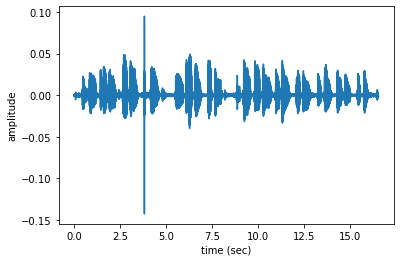

In [ ]:
n=0
fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(finfiles[n],sr=fs)
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

In [ ]:
MLENDHW_df.loc[finfiles[n].split('/')[-1]]

participant           S1
interpretation       hum
number                 2
song              Potter
Name: S1_hum_2_Potter.wav, dtype: object

In [ ]:
n=0
x, fs = librosa.load(finfiles[n],sr=fs)
print('This audio signal has', len(x), 'samples')

This audio signal has 730105 samples


In [ ]:
def getPitch(x,fs,winLen=0.02):
  #winLen = 0.02 
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  return f0,voiced_flag

The getXy function extracts the above mentioned features and returns them as a numpy array and lables name in y.

y has the following song labels:
1. Potter
2. StarWars

The first problem is to identify the name of each song. The next cell defines a function that takes a number of files and creates a NumPy array containing the 4 audio features used as predictors (`X`) and a binary label (`y`), that indicates whether is a Harry Potter song (`y=1`) or a StarWars (`y=0`).

In [ ]:
def getXy(files,labels_file, scale_audio=False, onlySingleDigit=False):
  X,y =[],[]
  for file in tqdm(files):
    fileID = file.split('/')[-1]
    file_name = file.split('/')[-1]
    yi = labels_file.loc[fileID]['song']=='Potter'
    if onlySingleDigit and yi>9:
      continue
    else:

      fs = None # if None, fs would be 22050
      x, fs = librosa.load(file,sr=fs)
      if scale_audio: x = x/np.max(np.abs(x))
      f0, voiced_flag = getPitch(x,fs,winLen=0.02)
      
    power = np.sum(x**2)/len(x)
    pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
    voiced_fr = np.mean(voiced_flag)

         #Extra Features 

    mfccs = np.mean(librosa.feature.mfcc(x, sr=fs))
    zcr = np.mean(librosa.feature.zero_crossing_rate(x))
    spc = np.mean(librosa.feature.spectral_centroid(x, fs))
    spr = np.mean(librosa.feature.spectral_rolloff(x, fs))
    rms = np.mean(librosa.feature.rms(x, fs))
      
      #mf1 = np.mean(mfccs)

    xi = [power,pitch_mean,pitch_std,voiced_fr,mfccs,zcr,spc,spr,rms]
    X.append(xi)
    y.append(yi)

  return np.array(X),np.array(y)

In [ ]:
X,y = getXy(finfiles, labels_file=MLENDHW_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 638/638 [32:34<00:00,  3.06s/it]


In [ ]:
print('The shape of X is', X.shape) 
print('The shape of y is', y.shape)
print('The labels vector is', y)

The shape of X is (638, 9)
The shape of y is (638,)
The labels vector is [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  T

In [ ]:

print(' The number of potter recordings is ', np.count_nonzero(y))
print(' The number of starwars recordings is ', y.size - np.count_nonzero(y))

 The number of potter recordings is  328
 The number of starwars recordings is  310


#Data Preprocessing

In [ ]:
# If nan sample, remove them
if np.sum(np.isnan(X)):
  idx = np.isnan(X).sum(1)>0
  X = X[~idx]
  y = y[~idx]
print(np.sum(np.isnan(X)))

0


Converting the numpy array to a combined Dataframe to help pre processing and visualization

In [ ]:
#Concatinatinag X,y

data_all = np.column_stack((X,y))

#numpy array to df

df = pd.DataFrame(data_all,columns=['power','pitch_mean','pitch_std','voiced_fr','mfccs','zcr','spc','spr','rms','y'])

Data Normalisation : We seperate the label and the features and then normalise this feature set.

In [ ]:
X = df.copy()
del X['y']
y = df['y'].copy()

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

df_normalized = scaler.fit_transform(X)

df_normalized = pd.DataFrame(df_normalized,columns=['power','pitch_mean','pitch_std','voiced_fr','mfccs','zcr','spc','spr','rms'])
df_normalized.head()

,power,pitch_mean,pitch_std,voiced_fr,mfccs,zcr,spc,spr,rms
0,-0.858848,-1.573005,-1.786590,-2.107083,0.566831,-0.577459,0.221722,1.020836,-1.630077
1,-0.432946,1.411682,-0.686065,-4.238157,1.612373,0.772721,1.093873,1.318758,-0.342803
2,0.332196,-0.861669,0.363285,0.896519,1.403035,-1.006501,-0.180208,-0.420942,1.024028
3,-0.045110,1.286044,-0.108182,0.252955,0.713602,0.225399,1.425943,1.519193,0.045301
4,1.248186,-0.813080,-0.955642,1.553595,0.653686,-1.147543,-1.427245,-1.283940,2.059066


#Data Visualization

Data visualization is the graphical representation of information and data. By using visual elements like charts, graphs, and maps, data visualization tools provide an accessible way to see and understand trends, outliers, and patterns in data.

1. Here we are plotting the number of files per song from the two songs i.e. Potter and StarWars. Here we can see that there are 328 audio files for Potter song and 310 audio files for StarWars song.
The audio files consist of both Hum and Whistle interpretation types.

Number of samples per Song: 

           song
Potter     328
StarWars   310


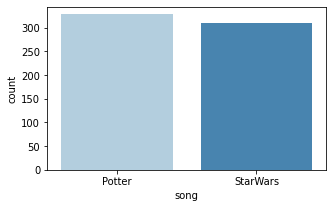

In [ ]:
Song_name = MLENDHW_df["song"].value_counts().to_frame() # Counting the number of samples per song
print("Number of samples per Song: \n\n" , Song_name)

plt.figure(figsize=(5,3))
sns.countplot(x="song", data=MLENDHW_df, palette="Blues")

plt.show()

2. Here we are plotting the number of Hum and Whistle interpretation files. We can see that 454 files are hum audio files whereas 184 are whistle audio files.

Number of samples per Interpretation: 

          interpretation
hum                 454
whistle             184


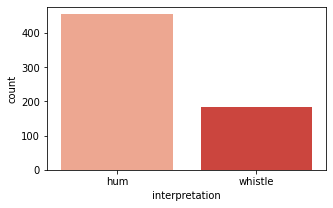

In [ ]:
Interpretation = MLENDHW_df["interpretation"].value_counts().to_frame() # Counting the number of samples per interpretation
print("Number of samples per Interpretation: \n\n" , Interpretation)

plt.figure(figsize=(5,3))
sns.countplot(x="interpretation", data=MLENDHW_df, palette="Reds")

plt.show()

# 5. Modelling 

Here we are going to build 2 different models and compare the performances of both on basis of their accuracy and precision.

1. **SVM(support-vector machines)**: The idea behind SVMs on which the SVC model is based is to find a separating hyperplane - a subspace with dimension one less than that of the feature space. Since there are infinite possible separating hyperplanes for any linearly separable feature space, an SVM computes which points are closest to each such hyperplane and uses them to construct a support vector. The SVM picks the hyperplane which maximizes the distance - margin - to each support vector. In this way, we maximize the separating ability of the chosen hyperplane.

2. **Random Forest Classifiers:** : They excellent models to use as a benchmark due to their low time complexity to train and because it is an ensemble method, their robustness to unknown distributions and outliers in the dataset, meaning Random Forests require relatively little exploratory analysis in both the data and training the model to get an idea of their performance in a task.

#6.Methodology

Two models which is SVM and Random Forest Classifiers are going to be used. Both the models will use 80% of the dataset for training and 20% of the dataset for validation. 
After training both models we will extract the accuracy, precision and confusion matrix to evaluate the performance. We know that various features affect the precision and accuracy of these models. 

#7. Dataset 

The dataset that is going to be used is a subset of the MLEnd Hums and Whistles dataset containing only hum and whistles of Potter and StarWars songs, those 2 songs accounted for 823 files. The dataset then was cleant based on the naming of each file, and 9 features were extracted from it and used as the predictors. After cleaning the final length of the dataset drop to 638, 328 of the was Harry Potter recordings and 310 of them StarWars. Out of these 454 are of Hum interpretation and 184 of them belong to the Whistle interpretation.

Then the name of each song was used as the label with the song for Harry Potter having 1 as it value and StarWars 0. That gave as a shape (638, 9) for the predictors and (638) for the labels. After that we broke the dataset into training (80%) and validating (20%) dataset with shapes (510, 9), (128, 9) for the predictors and (510,), (128,) for the labels respectively. Finally, the predictors values were normalized which leads to greater accuracy.

#8. Results

**Support Vector Machines (SVM)**

In [ ]:
from sklearn import svm
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((510, 9), (128, 9), (510,), (128,))

In [ ]:
from sklearn.model_selection import cross_validate
model  = svm.SVC(C=1)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.5235294117647059
Validation  Accuracy 0.578125
The support vectors are (501, 9)


In [ ]:
mean = X_train.mean(0)
sd =  X_train.std(0)

X_train = (X_train-mean)/sd
X_val  = (X_val-mean)/sd

model  = svm.SVC(C=1,gamma=2)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.9764705882352941
Validation  Accuracy 0.6015625
The support vectors are (504, 9)


In [ ]:
from sklearn.metrics import confusion_matrix

train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=model.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=model.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[239  10]
 [  2 259]]

Validation confusion matrix:
 [[28 33]
 [18 49]]

Normalised training confusion matrix:
 [[0.95983936 0.04016064]
 [0.00766284 0.99233716]]

Normalised validation confusion matrix:
 [[0.45901639 0.54098361]
 [0.26865672 0.73134328]]



**Comparision between different models**

Comparing different models like GaussianNB, DecisionTreeClassifier, KneighboursClassifier, RandomForestClassifier, QuadraticDiscriminantAnalyser, AdaBoostClassifier with SVC model (kernel = RBF). Finding the best model with higher accuracy

In [ ]:
mean = X_train.mean(0)

sd =  X_train.std(0)


from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier
from sklearn.svm import SVC


X_train = (X_train-mean)/sd
X_val  = (X_val-mean)/sd

classification_models = [
                         GaussianNB(),
                         DecisionTreeClassifier(),
                         KNeighborsClassifier(),
                         RandomForestClassifier(),
                         AdaBoostClassifier(),
                         SVC(kernel='rbf'),
                         QuadraticDiscriminantAnalysis()
]
scores = []
for model in classification_models:
  model.fit(X_train,y_train)
  score=model.score(X_val,y_val)
  model_name=type(model).__name__
  if model_name=='SVC' and model.kernel=='rbf': model_name='RBF kernel'
  scores.append((model_name,(f'{100*score:.2f}%')))
scores_df = pd.DataFrame(scores,columns=['Classifier','Accuracy Score'])
scores_df.sort_values(by = 'Accuracy Score',axis = 0, ascending = False)

,Classifier,Accuracy Score
1,DecisionTreeClassifier,61.72%
3,RandomForestClassifier,61.72%
5,RBF kernel,59.38%
2,KNeighborsClassifier,58.59%
6,QuadraticDiscriminantAnalysis,57.03%
0,GaussianNB,56.25%
4,AdaBoostClassifier,52.34%


**Observations**: It is observed that Decision Tree Classifier has the better validation accuracy amongst all the models. 

**Using Cross_validation to compare accuracy**

In [ ]:
list1 = []
list2 = []
for model in classification_models:
  cv_results = cross_validate(model, X, y, cv=10)
  model_name=type(model).__name__
  print(model_name)
  #print(cv_results['test_score'])
  a = np.average(cv_results['test_score'])
  list1.append(model_name)
  list2.append(a)
  print(a)
df_crossvalidate = pd.DataFrame(data = list2,index = list1,columns=['Accuracy'] )
a = df_crossvalidate.sort_values(by = 'Accuracy',axis = 0, ascending = False)
display(a)

GaussianNB
0.5406994047619047
DecisionTreeClassifier
0.5597222222222221
KNeighborsClassifier
0.4607142857142857
RandomForestClassifier
0.6238591269841269
AdaBoostClassifier
0.6192956349206349
SVC
0.5142361111111111
QuadraticDiscriminantAnalysis
0.5282490079365079


,Accuracy
RandomForestClassifier,0.623859
AdaBoostClassifier,0.619296
DecisionTreeClassifier,0.559722
GaussianNB,0.540699
QuadraticDiscriminantAnalysis,0.528249
SVC,0.514236
KNeighborsClassifier,0.460714


**Observations:** *For training data, Decision Tree Classifier gives an accuracy of `61.72%` and after using Cross_Validation the accuracy observed of Random Forest Classifier is better than Decision Tree Classifier.* 

**Grid Search CV**

This section focuses on: 

*   Finding the best value of C and gamma value for SVC 
*   Creating a Confusion Matrix


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn import metrics
from sklearn.model_selection import GridSearchCV
import seaborn as sn

# Defining the C value, Gamma and kernel
param_grid = { 'C':[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,6,7,8,9,10,11],'kernel': ['rbf'],'gamma':[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,6,7]}
grid = GridSearchCV(SVC(),param_grid,refit=True,verbose=2)
grid.fit(X_train,y_train)

# Printing the best parameter value
print("Best Parameter Value: \n\n", grid.best_params_)
grid_predictions=grid.predict(X_val)

Fitting 5 folds for each of 320 candidates, totalling 1600 fits
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.2, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.2, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.2, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.2, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.2, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=0.3, kernel=rbf; total time=   0.0s
[CV] END .......................C=0.1, gamma=

**Observations:** Having C = 7 & Gama = 0.3 gives the best value

              precision    recall  f1-score   support

         0.0       0.59      0.57      0.58        61
         1.0       0.62      0.64      0.63        67

    accuracy                           0.61       128
   macro avg       0.61      0.61      0.61       128
weighted avg       0.61      0.61      0.61       128



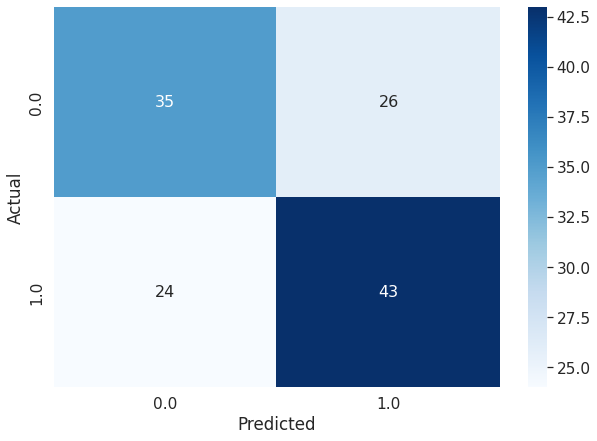

In [ ]:
# Printing the confusion matrix
con_mat = confusion_matrix(y_val,grid_predictions)

# Printing the Classification Report
print(classification_report(y_val,grid_predictions))
df_cm =pd.DataFrame(con_mat, columns=np.unique(y_val), index = np.unique(y_val))
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sn.set(font_scale=1.4)#for label size
sn.heatmap(df_cm, cmap="Blues", annot=True,annot_kws={"size": 16})# font size

The confusion matrix is an intuitive measure of the precision and recall of our model w.r.t. each song. Precision is a measure of how many positive predictions are true positives, and recall is a measure of how many positives we actually predicted from all positive samples in the dataset: Lower precision means we have more false positives, while lower recall means we have more false negatives. For this dataset, precision of each song is how often we correctly predict it and recall is how many of that song we predicted out of all samples with that song in the dataset.

**Random Forest Classifier**



In [ ]:
from sklearn.ensemble import RandomForestClassifier

parameters = {
    'max_depth': [7,8,9,10],
    'criterion': ['gini', 'entropy'],
    'n_estimators':[200,300,400],
    'bootstrap': ['False'],
    'class_weight': ['balanced', 'balanced_subsample']
}

grid_rf = RandomForestClassifier()
grid_forest = GridSearchCV(grid_rf, parameters, n_jobs=-1)

grid_forest.fit(X_train,y_train)

yt_p = grid_forest.predict(X_train)
yv_p = grid_forest.predict(X_val)

In [ ]:
#Scores and Best Model Parameters

print (grid_forest.best_score_)
print (grid_forest.best_params_)

0.6196078431372549
{'bootstrap': 'False', 'class_weight': 'balanced_subsample', 'criterion': 'entropy', 'max_depth': 10, 'n_estimators': 300}


In [ ]:
#Running the best classifier
clf_1 = RandomForestClassifier(max_depth=10,  criterion='entropy', n_estimators=300, bootstrap=False, class_weight='balanced',n_jobs=-1)
clf_1.fit(X_train, y_train)

RandomForestClassifier(bootstrap=False, class_weight='balanced',
                       criterion='entropy', max_depth=10, n_estimators=300,
                       n_jobs=-1)

In [ ]:
yt_p = clf_1.predict(X_train)
yv_p = clf_1.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))

Training Accuracy 1.0
Validation  Accuracy 0.609375


In [ ]:
print(classification_report(y_val, yv_p))

              precision    recall  f1-score   support

         0.0       0.60      0.56      0.58        61
         1.0       0.62      0.66      0.64        67

    accuracy                           0.61       128
   macro avg       0.61      0.61      0.61       128
weighted avg       0.61      0.61      0.61       128



#9. Conclusions

In conclusion we can see that by normalizing our data the results improve radically. When you compare both the models we can see that Random Forests perform better than SVM. However, looking at the difference between training and validation accuracies SVM and Random Forest Classifiers overfit. From 823, the data sample numbers come down to 638 as the naming convention was wrong for few Potter files and max names were "StartWars" instead of "StarWars". I would like to add an algorithm to rectify the names instead of discarding the files. 
After comparing the accuracies of all models, we can infer that the 3 best models are Random Forest Classifiers, Ada Boost Classfier and Decision Tree Classifier respectively. 